Building object detection and image segmentation models is slightly different from other models. Majorly because you have to use specialized models and prepare the data in a particular way. This article will examine how to perform object detection and image segmentation on a custom dataset using the TensorFlow 2 Object Detection API.

Let’s dive right in!

Object detection datasets
In this article, we’ll use the Coco Car Damage Detection Dataset available on Kaggle. It contains car images with damages. It can be used to train a model to detect damages on cars and car parts. The dataset has already been annotated, and the corresponding COCO files are provided.

# Preparing datasets for object detection
If you have a custom dataset you’d like to use, then you have to do the labeling and annotation yourself. There are many tools and online platforms that can help you achieve this. If you would like to stick to open source, Labelme is an excellent alternative.

The video below shows how to create polygons on the car dataset. After completing an annotation, you will have to save it. Once you save it, Labelme will store the resulting JSON file in the same folder as the data.


- Roboflow Universe provides numerous object detection and image segmentation datasets. You can search the platform and switch the car images dataset. If you choose that route, download the TFRecord format from the platform. If you have a custom dataset, you can also perform the annotation on Roboflow.
- Ango AIprovides some public datasets to kickstart your classification and object detection projects. They also offer a platform that you can use to label and annotate the images.
Segments AI lists some object detection and image segmentation datasets that you can clone into your projects. You can also perform annotation on their platform.
# What is TensorFlow 2 Object Detection API?
The TensorFlow Object Detection API is an open-source computer vision framework for building object detection and image segmentation models that can localize multiple objects in the same image. The framework works for both TensorFlow 1 and 2. Users are, however, encouraged to use the TF 2 version because it contains new architectures.

Some of the architectures and models that TensorFlow 2 Object Detection API supports include:

-CenterNet
-EfficientDet
-SSD MobileNet
-SSD ResNet
-Faster R-CNN
-ExtremeNet
-Mask RCNN
The models can be downloaded from the TensorFlow 2 Detection Model Zoo. You need their corresponding config files to train one of the object detection models from scratch. In this project, we’ll use the Mask RCNN model, but you can also try the other models.

# Step 1
## Install TensorFlow 2 Object Detection API on Google Colab

At this point, you now have an object detection dataset. Either the car images data and the corresponding COCO JSON files or a dataset you have created yourself or downloaded somewhere.

We will run this project on Google Colab to utilize free GPU resources for training the model. Let’s install the TensorFlow 2 Object Detection API on Colab. The first step is to clone the TF 2 Object Detection GitHub repo:

In [1]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 80048, done.
remote: Counting objects: 100% (233/233), done.
remote: Compressing objects: 100% (137/137), done.
remote: Total 80048 (delta 112), reused 204 (delta 94), pack-reused 79815
Receiving objects: 100% (80048/80048), 594.50 MiB | 17.68 MiB/s, done.
Resolving deltas: 100% (56957/56957), done.


In [38]:
import matplotlib
import matplotlib.pyplot as plt
import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf
from google.colab import files
import pathlib
import itertools
import random

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

from object_detection.utils import config_util
from object_detection.utils import colab_utils
from object_detection.builders import model_builder
%matplotlib inline

Next, run these commands to install TF 2 Object Detection API on Colab:

In [10]:
# Copy setup files into models/research folder
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=. # Install TensorFlow Object Detection API.
cp object_detection/packages/tf2/setup.py .
python -m pip install --use-feature=2020-resolver .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1696474 sha256=0f82a9f38c1bf2aa40c73667e609147a0d269554b752fa0f927f848605703582
  Stored in directory: /tmp/pip-ephem-wheel-cache-yfibunpo/wheels/7d/96/c1/072a751379735e8dfdada1def1c62a89afb3cc45654fd6fd28
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=45775105c9a5e28a9c9fd14c0134765be63237c762f82f71e181cc4799908961
  Stored in directory: /root/.cache/pip/wheels/07/35/78/e9004fa30578734db7f10e7a211605f3f0778d2bdde38a239d
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44009 sha256=e71589fb15671eb63909abdac3848c2b1492ba1e752f8cd4f2160504a1facc1a
  Stored in directory: /root/.cache/pip/wheels/bb/73/e9/d273421f5723c4bf544dcf9eb097bda94421ef8d3252699f0a
  Created wheel for docopt: filename=docopt-

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


# *Download object detection dataset*
The dataset and the config file for the model we’ll be training can be downloaded from this GitHub repo. You have to make some changes after you download the config from the object detection repo. We’ll discuss those changes in a moment.

In [11]:
!git clone https://github.com/mlnuggets/maskrcnn.git

Cloning into 'maskrcnn'...
remote: Enumerating objects: 130, done.
remote: Total 130 (delta 0), reused 0 (delta 0), pack-reused 130
Receiving objects: 100% (130/130), 31.96 MiB | 10.38 MiB/s, done.
Resolving deltas: 100% (24/24), done.


# **Download Mask R-CNN model**
The next step is to download the Mask R-CNN model that we’ll fine tune. Extract the file to get the trained model checkpoint.

In [14]:
pip install wget

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9674 sha256=8d478cb6bccbea96f1a660cd3de24f00ef201507a15517791bbf24e010d5cf30
  Stored in directory: /root/.cache/pip/wheels/bd/a8/c3/3cf2c14a1837a4e04bd98631724e81f33f462d86a1d895fae0
Successfully built wget


In [15]:
import wget
model_link = "http://download.tensorflow.org/models/object_detection/tf2/20200711/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz"
wget.download(model_link)
import tarfile
tar = tarfile.open('/content/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz')
tar.extractall('.') 
tar.close()

The compressed file also contains the model’s configuration file. You will always have to edit this file after downloading each model.

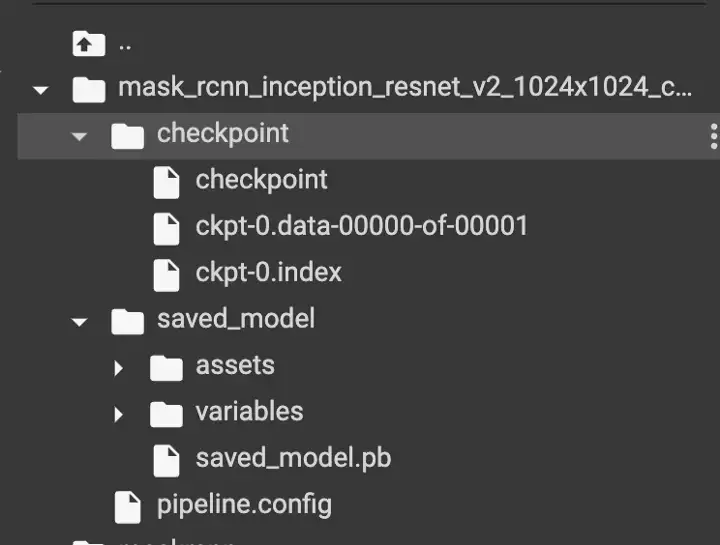

Let’s look at the items in the configuration file that you need to update.

## Edit the object detection pipeline config file
The config file you’ll get after cloning this repo has been edited to run smoothly on Google Colab. If you are running this project elsewhere you’ll need to update the file paths. In a nutshell, here are the items you need to update after downloading the Mask RCNN config file from the TensorFlow 2 Object Detection API repo:
- num_classes to 5 because the dataset has 5 classes, headlamp, front_bumper, hood, door, and rear_bumper.
-image_resizer to 512 from 1024 reducing the size of the images hence reducing training time.
- num_steps to 1000 from 200000 to reduce the training time. The more the steps the longer it will take to train the model. You can increase the steps if the loss is still decreasing and validation metrics are going up.
- batch_size = 1 to dictate the number of images to be fed in memory while training.
- fine_tune_checkpoint to point to the path of the Mask R-CNN model downloaded above. This ensures that we are not training the model from scratch.
- fine_tune_checkpoint_type to detection from classification since we are training an object detection model.
- train_input_reader to point to the label_map_path and path to the TFRecords. More on TF Records later.
- eval_input_reader is the same as train_input_reader but for the test data.

# Convert the images to TFRecords
The object detection models expect the images to be in TFRecord format. Fortunately, the TensorFlow 2 Object Detect API repo provides a script for performing the conversion. The script takes the following arguments:

- Directory of the training images.
- Folder containing the test images.
- File containing training image annotations.
- File containing test image annotation.
- Directory where the generated TFRecords should be stored.

In [16]:
!python /content/maskrcnn/create_coco_tf_record.py --logtostderr \
      --train_image_dir=/content/maskrcnn/data/train  \
      --test_image_dir=/content/maskrcnn/data/val \
      --train_annotations_file=/content/maskrcnn/data/train/COCO_mul_train_annos.json \
      --test_annotations_file=/content/maskrcnn/data/val/COCO_mul_val_annos.json \
      --output_dir=/content/maskrcnn/data/tf_records

2023-01-02 08:24:06.042548: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-02 08:24:07.032159: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-02 08:24:07.032327: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-02 08:24:07.032353: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF

# **Train the model**
You now have everything you need to train this Mask R-CNN object detection model. The next step is to run the training script. The model training script takes the following arguments:

- pipeline_config_path the path to the updated model configuration file.
- model_dir the directory where the trained model will be saved.


In [17]:

!python /content/models/research/object_detection/model_main_tf2.py\
    --pipeline_config_path=/content/maskrcnn/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8-colab.config \
    --model_dir=/content/training \
    --alsologtostderr

2023-01-02 08:24:45.051976: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-02 08:24:46.159180: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-02 08:24:46.159321: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-02 08:24:46.159346: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF

You might get an OpenCV error on Colab. This error can be fixed by installing the right version of OpenCV.

In [ ]:
pip uninstall opencv-python-headless==4.5.5.62 
pip install opencv-python-headless==4.5.2.52
#If you get a cuDNN error, you can fix it by installing the right version of cuDNN.
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

# Model evaluation and visualization
When training is complete, you can run TensorBoard to show the visualization of the training and testing metrics such as the localization loss.



In [18]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

<IPython.core.display.Javascript object>

# **Run conversion script**
The next step is to export the model for inference. The conversion script expects:

- trained_checkpoint_dir the last checkpoint of the trained model.
- output_directory where the exported model will be saved.
- pipeline_config_path the path to the pipeline configuration file.
The conversion script will output checkpoint files, a SavedModel, and the model config file.

In [19]:
pipeline_file = '/content/maskrcnn/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8-colab.config'
last_model_path = '/content/training/'
output_directory = "/content/finetuned-maskrcnn"
!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

2023-01-02 08:49:15.764784: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-02 08:49:16.791822: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-02 08:49:16.791956: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-02 08:49:16.791980: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF

# Download model from Google Colab
You may want to download the converted model or trained model. That can be done by zipping the files and using Colab utilities to download the compressed file.

In [31]:
from google.colab import files
!zip -r /content/maskrcnn.zip /content/training
!zip -r /content/fine_tuned_model.zip /content/finetuned-maskrcnn
files.download("/content/maskrcnn.zip")
files.download("/content/fine_tuned_model.zip")

updating: content/training/ (stored 0%)
updating: content/training/ckpt-2.index (deflated 83%)
updating: content/training/ckpt-1.data-00000-of-00001 (deflated 7%)
updating: content/training/checkpoint (deflated 56%)
updating: content/training/ckpt-2.data-00000-of-00001 (deflated 8%)
updating: content/training/ckpt-1.index (deflated 81%)
updating: content/training/train/ (stored 0%)
updating: content/training/train/events.out.tfevents.1672647902.1deb1ec85015.4882.0.v2 (deflated 0%)
updating: content/finetuned-maskrcnn/ (stored 0%)
updating: content/finetuned-maskrcnn/saved_model/ (stored 0%)
updating: content/finetuned-maskrcnn/saved_model/saved_model.pb (deflated 93%)
updating: content/finetuned-maskrcnn/saved_model/fingerprint.pb (stored 0%)
updating: content/finetuned-maskrcnn/saved_model/variables/ (stored 0%)
updating: content/finetuned-maskrcnn/saved_model/variables/variables.data-00000-of-00001 (deflated 7%)
updating: content/finetuned-maskrcnn/saved_model/variables/variables.ind

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Object detection with Mask R-CNN
It’s now time to use the trained Mask R-CNN model to perform object detection on test car images. Luckily, the TensorFlow 2 Object Detection API provides all the utilities needed to do this. The first one is a function that loads an image and converts it into a NumPy array.

In [32]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.
  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.
  Args:
    path: a file path.
  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

# Load an image from file into a NumPy array
The function expects a path to an image file and returns a NumPy array.

# Visualize detections
The next utility is a function for plotting the detections using Matplotlib.

In [33]:
def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.
  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

Create model from the last checkpoint
Let’s now create a detection model from the last saved model checkpoint.

In [39]:
from pathlib import Path
import pathlib
filenames = list(pathlib.Path('/content/training/').glob('*.index'))
filenames.sort()
print(filenames)
#recover our saved model
model_dir = '/content/training/'
#generally you want to put the last ckpt from training in here
configs = config_util.get_configs_from_pipeline_file(pipeline_file)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(str(filenames[-1]).replace('.index','')))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

[PosixPath('/content/training/ckpt-1.index'), PosixPath('/content/training/ckpt-2.index')]


## Map **labels** for inference decoding
Next, we declare variables that are important for decoding the model output. For instance, the categories and file containing the training categories.

In [40]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

# Run detector on test image
The next step is to run the Mask R-CNN object detection model on some test images.

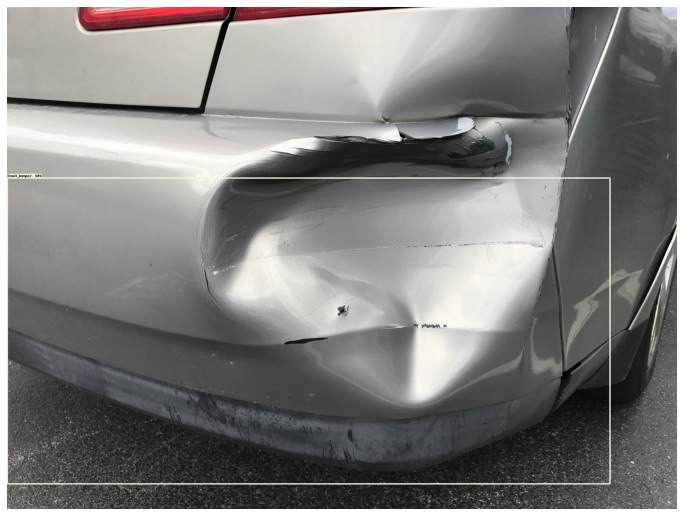

In [42]:
#run detector on test image
#it takes a little longer on the first run and then runs at normal speed. 
TEST_IMAGE_PATHS = glob.glob('/content/cosmetic-damage.jpeg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.show()

# Image segmentation with Mask R-CNN
The Mask R-CNN object detection model can be used for both object detection and image segmentation. Let’s start by loading the fined tuned model.

In [43]:

def load_model(model_dir):
    
    model = tf.saved_model.load(str(model_dir))
    return model
model_dir = '/content/finetuned-maskrcnn/saved_model'
masking_model = load_model(model_dir)

# Set label map
The model also needs labels for decoding the output.

In [44]:

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/maskrcnn/data/labelmap.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

# Set test image paths
The next step is to define the path to the test images. In this case, we’ll use all the test images because they aren’t that many.



In [45]:
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('/content/maskrcnn/data/test')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))

# Create inference function
The segmentation utility is also provided on the TensorFlow 2 Object Detection API repo.



In [46]:
def run_inference_for_single_image(model, image_np):
    
    print("Running inference for : ",image_path)

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)
    
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    detections = model(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop("num_detections"))

    detections = dict(itertools.islice(detections.items(), num_detections))

    detections["num_detections"] = num_detections

    image_np_with_detections = image_np.copy()

    # Handle models with masks:
    if "detection_masks" in detections:
        # Reframe the the bbox mask to the image size.
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              detections["detection_masks"][0], detections["detection_boxes"][0],
               image_np.shape[0], image_np.shape[1])      
        detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
        detections["detection_masks_reframed"] = detection_masks_reframed.numpy()

    boxes = np.asarray(detections["detection_boxes"][0])
    classes = np.asarray(detections["detection_classes"][0]).astype(np.int64)
    scores = np.asarray(detections["detection_scores"][0])
    mask = np.asarray(detections["detection_masks_reframed"])

    # Visualizing the results
    viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        boxes,
        classes,
        scores,
        category_index,
        instance_masks=mask,
        use_normalized_coordinates=True,
        line_thickness=3)
    
    # Display image with detections and segmented parts
    display(Image.fromarray(image_np_with_detections))

# Perform segmentation and detection
The next step is to load an image as a NumPy array and use the above function to start detecting objects.

Running inference for :  /content/maskrcnn/data/test/11.jpg


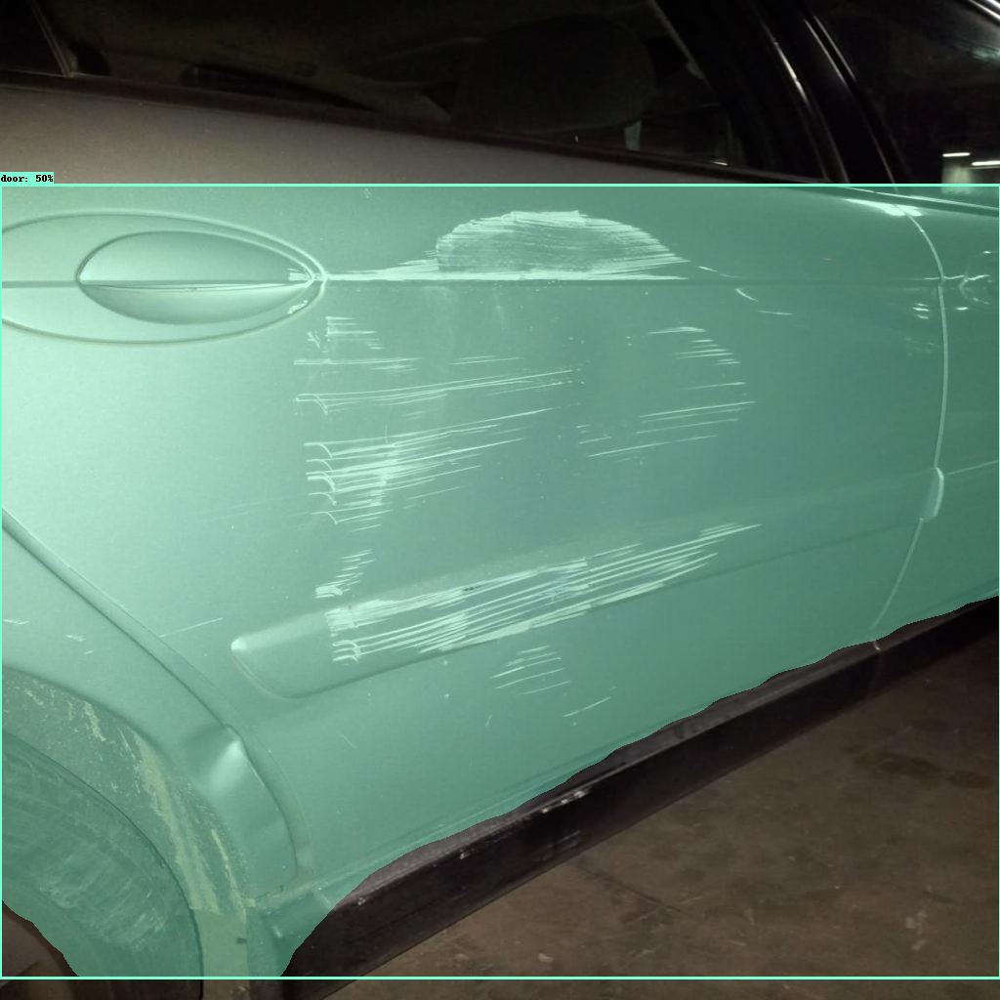

Running inference for :  /content/maskrcnn/data/test/12.jpg


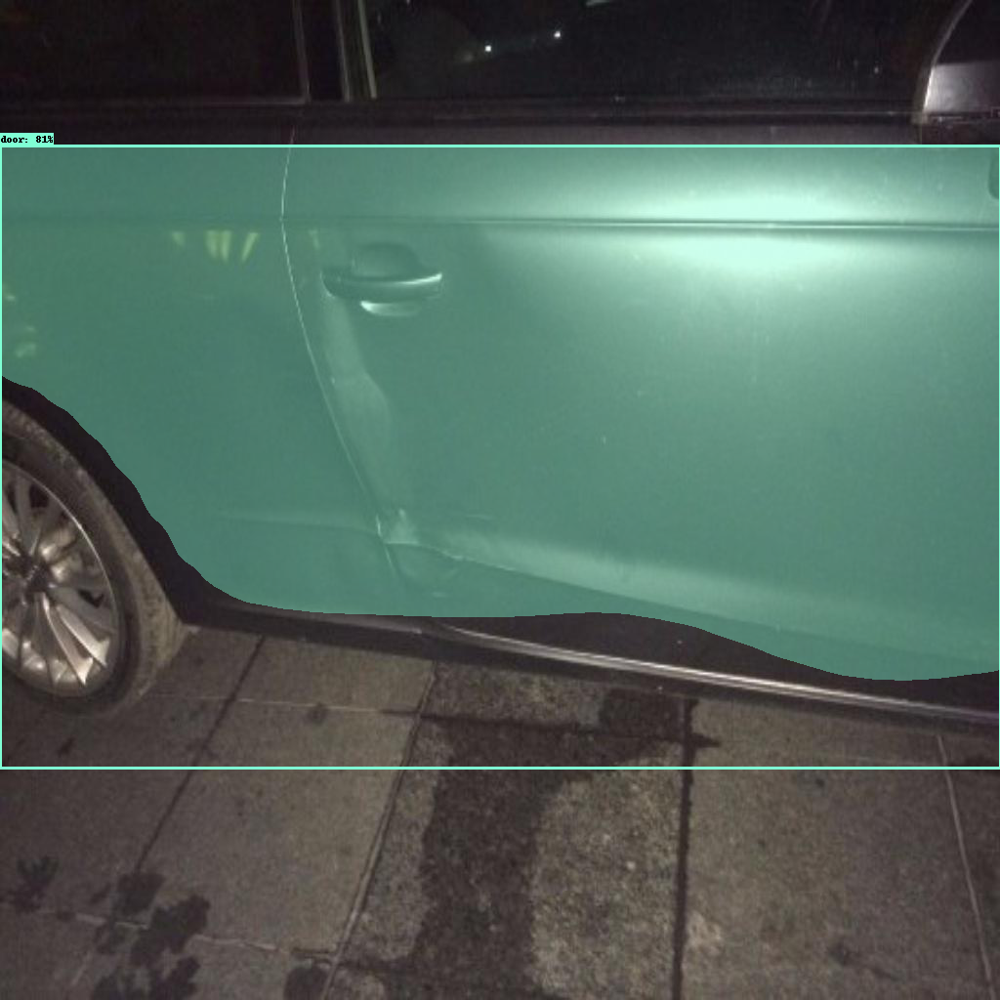

Running inference for :  /content/maskrcnn/data/test/28.jpg


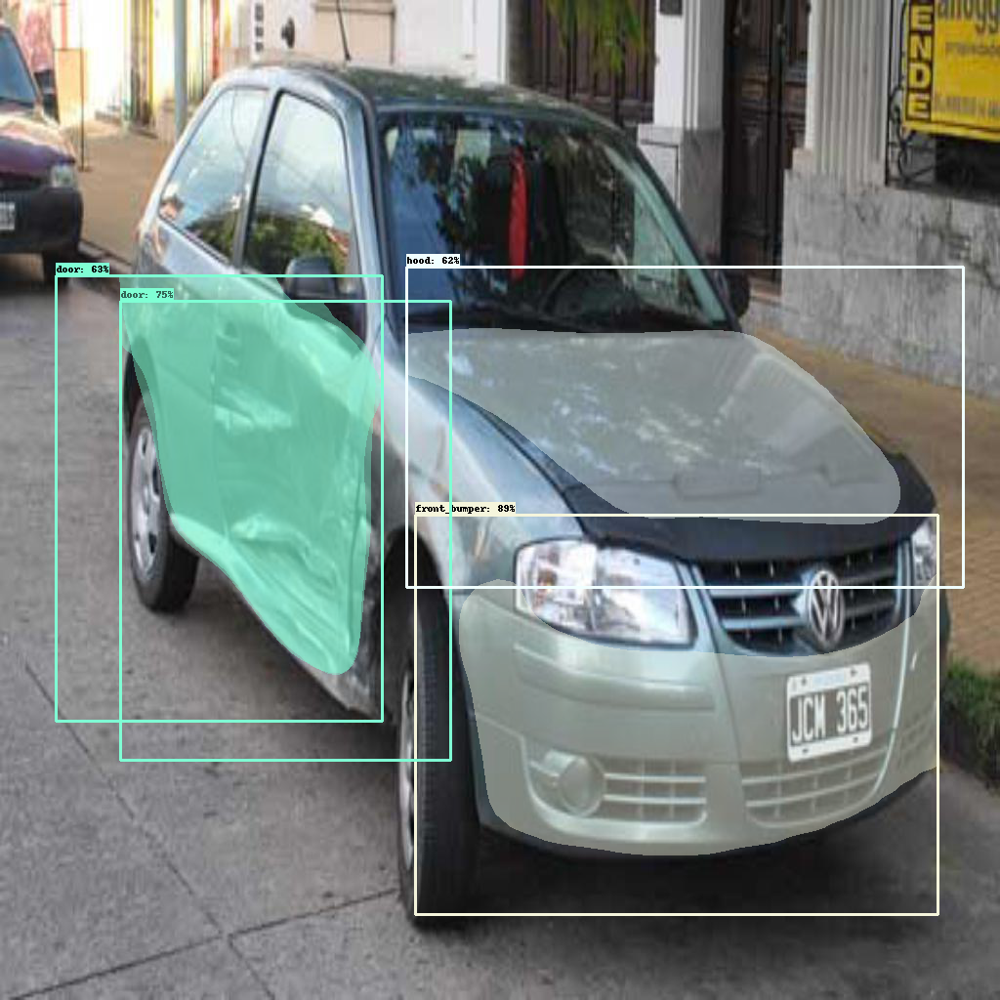

Running inference for :  /content/maskrcnn/data/test/45.jpg


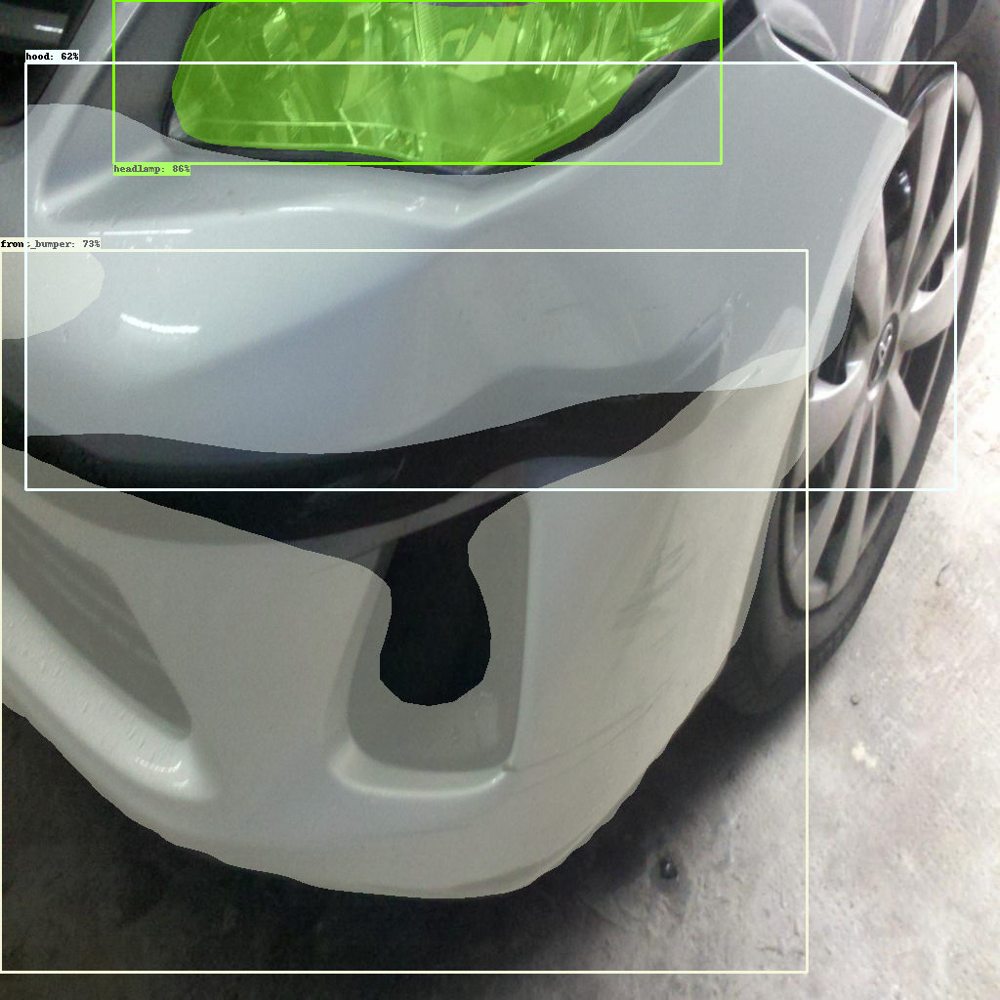

Running inference for :  /content/maskrcnn/data/test/60.jpg


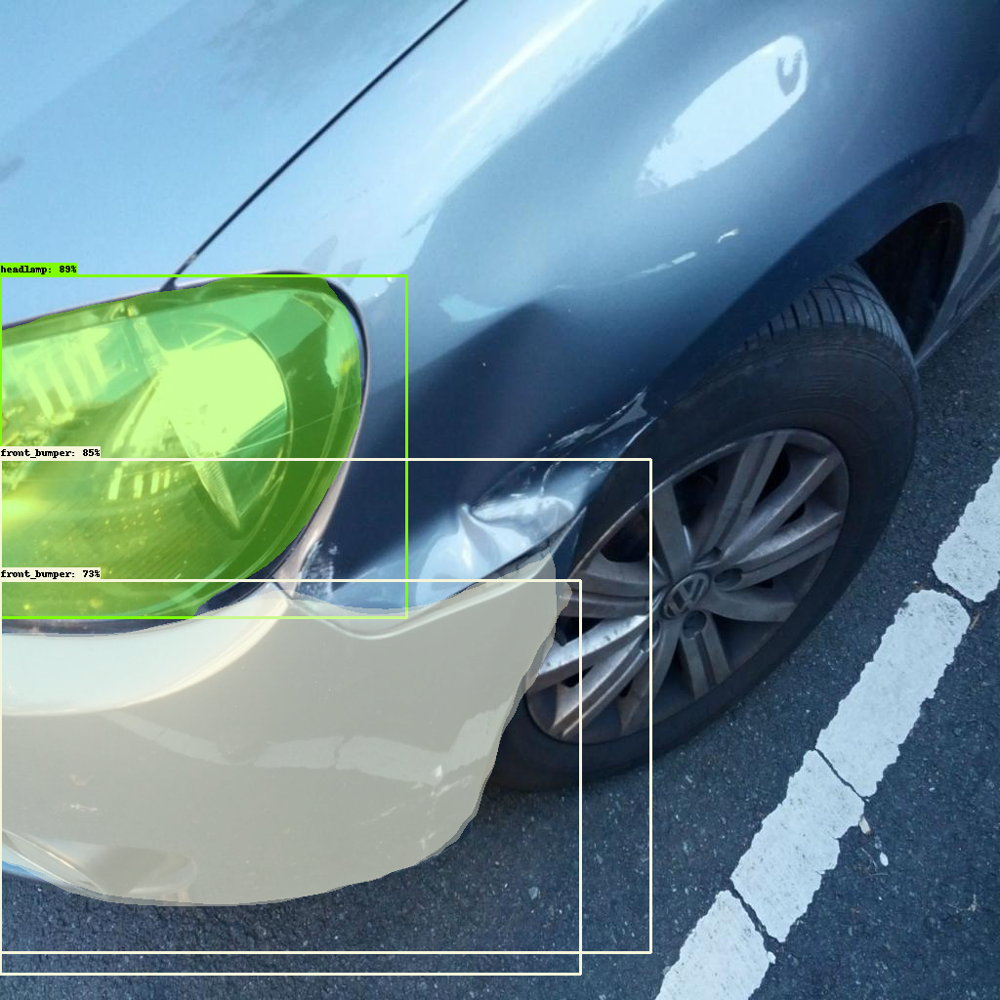

Running inference for :  /content/maskrcnn/data/test/66.jpg


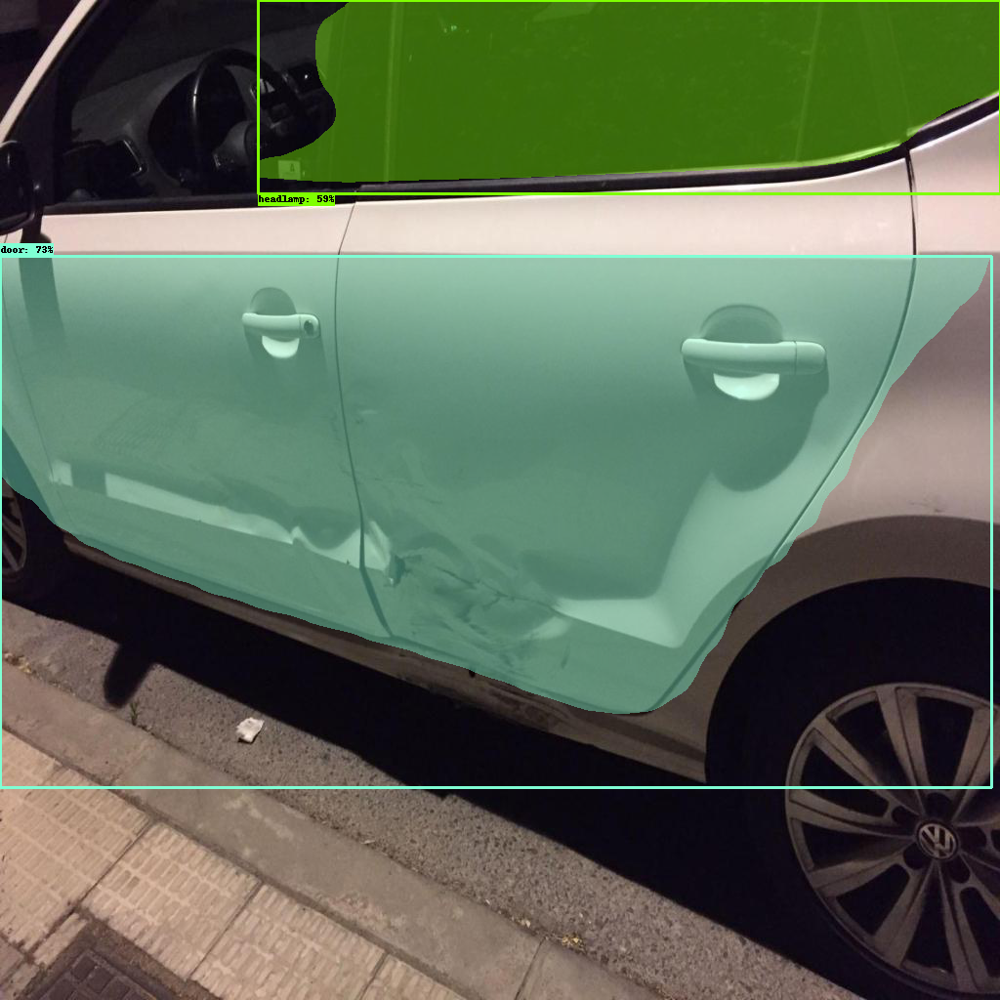

Running inference for :  /content/maskrcnn/data/test/67.jpg


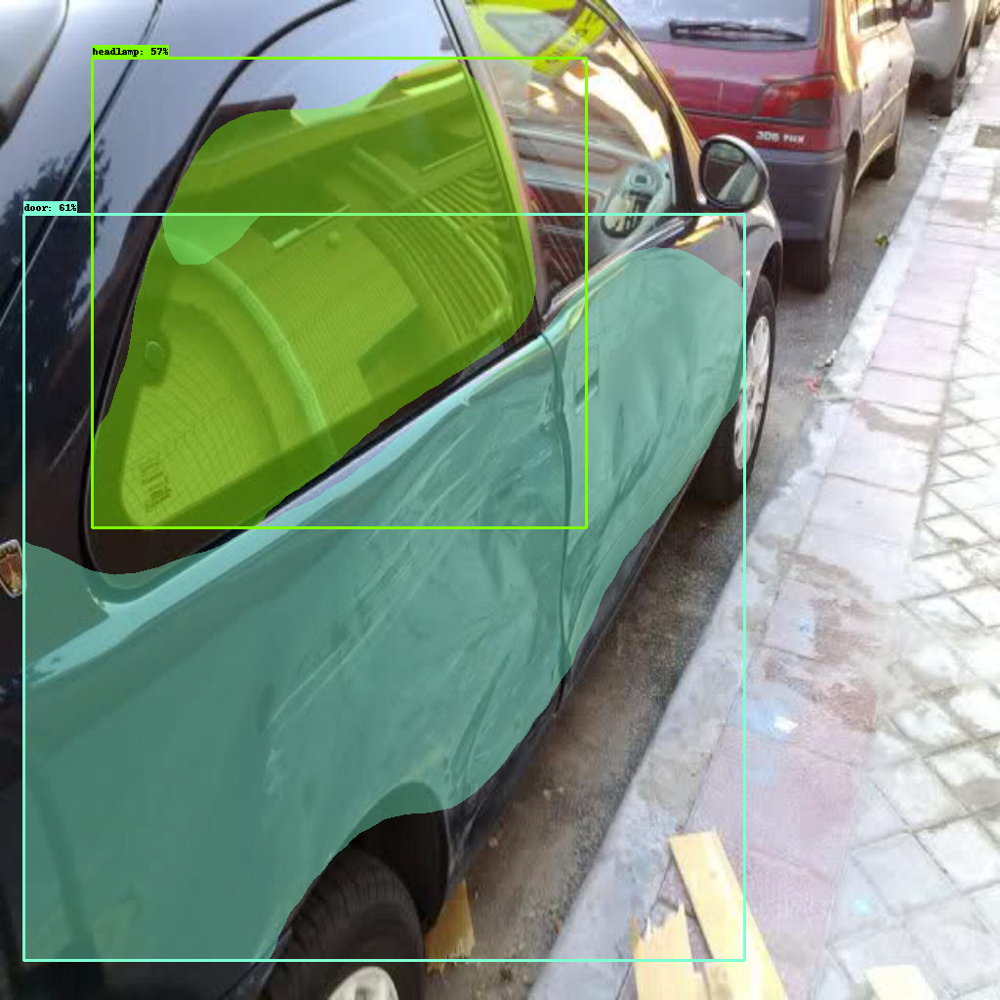

Running inference for :  /content/maskrcnn/data/test/72.jpg


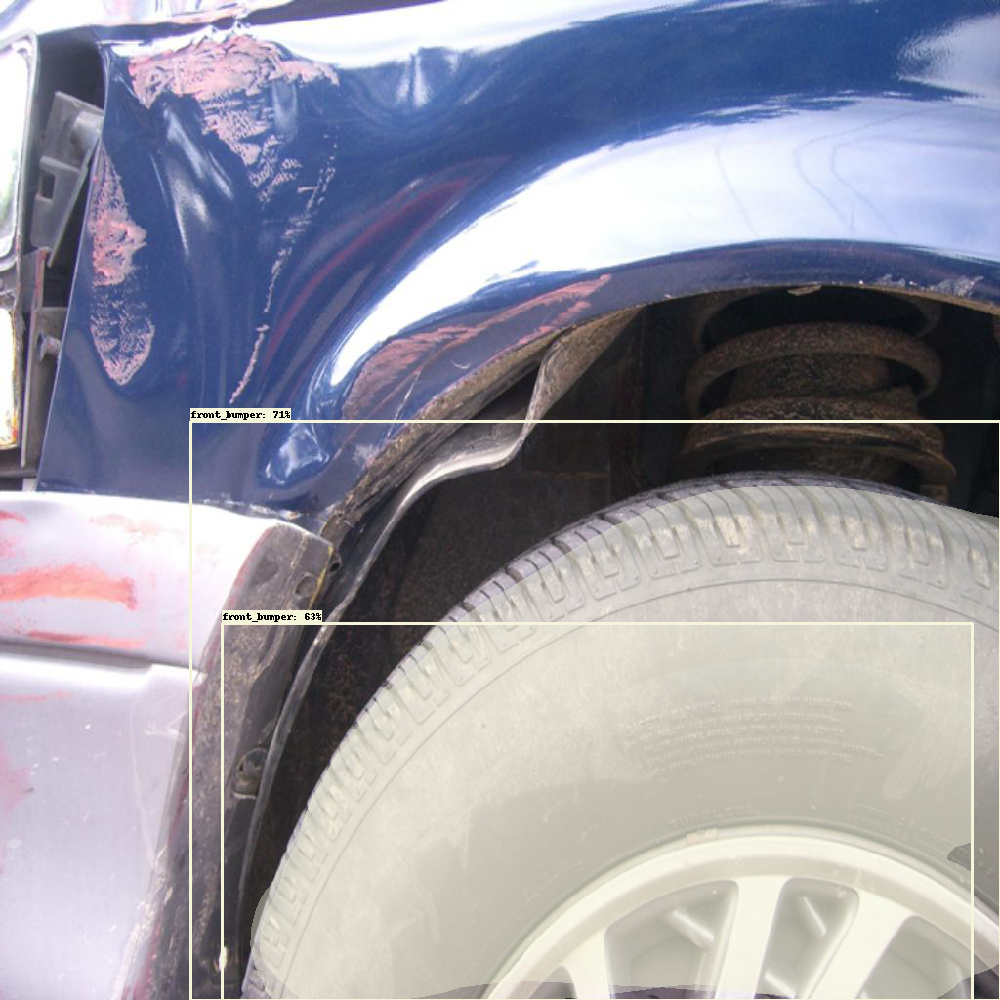

In [47]:
def show_inference(model, image_path):

    # Load image
    image_np = np.array(Image.open(image_path))
    
    # Actual detection.
    output_dict = run_inference_for_single_image(model, image_np)
  
for image_path in TEST_IMAGE_PATHS:
    show_inference(masking_model, image_path)